# South Carolina
We will be analyzing the congressional district map passed in 2021 in South Carolina followwing the 2020 census. Currently South Carolina's congressional map is in litigation so we want to examine how that could have effected the 2024 U.S. House election.

## Import Required Packages

In [2]:
# For working with graphs
import networkx as nx

# For making plots
import matplotlib.pyplot as plt
import numpy as np

# For getting graph
from gerrychain import Graph, Partition, proposals, updaters, constraints, accept, MarkovChain, GeographicPartition

# For making and working with shapefiles
import geopandas as gpd
import pandas as pd

# Other necessary packages
import random
import maup
from maup import smart_repair, quick_repair

## Setting up our dataset
We want all the senate election results and voter demographics by precincts, so we will have to merge different datasets to do so. This section works through the code to create our desired shapefile dataset which we will save to github so we don't have to run the joins everytime we do analysis.

### Import Congressional Districting Plans

In [3]:
# Import SC data into a geodataframe
sc_cong_gdf = gpd.read_file("S865_Congress/S865_Congress.shp")

We need to confirm that there aren't any issues in the Districts, so we can use the "maup" package.

In [4]:
# Check geodataframe using maup's doctor function
maup.doctor(sc_cong_gdf)

/Users/annef/anaconda3/envs/polidist/lib/python3.11/site-packages/maup/repair.py:331: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  overlaps = inters[inters.area > 0].make_valid()


True

We are good to use these shapefiles.

### Import and Tidy Election Data

In [5]:
# Import 2022 General Election voting data
sc_data_gdf = gpd.read_file('sc_2022_gen_st_prec/sc_2022_gen_st_prec.shp')
sc_data_gdf.columns

Index(['UNIQUE_ID', 'COUNTYFP', 'County', 'Precinct', 'Prec_Code', 'G22A1NO',
       'G22A1YES', 'G22A2NO', 'G22A2YES', 'G22AGRCNEL', 'G22AGRGEDM',
       'G22AGROWRI', 'G22AGRRWEA', 'G22ATGOWRI', 'G22ATGRWIL', 'G22COMOWRI',
       'G22COMRECK', 'G22GOVDCUN', 'G22GOVLREE', 'G22GOVOWRI', 'G22GOVRMCM',
       'G22SOSDBUT', 'G22SOSOWRI', 'G22SOSRHAM', 'G22SUPAELL', 'G22SUPDELL',
       'G22SUPGMIC', 'G22SUPOWRI', 'G22SUPRWEA', 'G22TREAWOR', 'G22TREOWRI',
       'G22TRERLOF', 'G22USSDMAT', 'G22USSOWRI', 'G22USSRSCO', 'geometry'],
      dtype='object')

In [6]:
# List of specific columns to keep
columns_to_keep = ['UNIQUE_ID', 'COUNTYFP', 'County', 'Precinct', 'Prec_Code', 'geometry', "G22USSDMAT", "G22USSRSCO"]

# Filter the GeoDataFrame
sc_data_gdf = sc_data_gdf[columns_to_keep]

# Check that we've kept the right stuff
sc_data_gdf

,UNIQUE_ID,COUNTYFP,County,Precinct,Prec_Code,geometry,G22USSDMAT,G22USSRSCO
0,ABBEVILLE-:-ABBEVILLE NO. 1,001,ABBEVILLE,ABBEVILLE NO. 1,001,"POLYGON ((1606939.510 874521.176, 1606937.194 ...",212,772
1,ABBEVILLE-:-ABBEVILLE NO. 2,001,ABBEVILLE,ABBEVILLE NO. 2,002,"POLYGON ((1594909.405 858817.595, 1594971.672 ...",395,236
2,ABBEVILLE-:-ABBEVILLE NO. 3,001,ABBEVILLE,ABBEVILLE NO. 3,003,"POLYGON ((1583078.122 855552.541, 1583107.248 ...",224,361
3,ABBEVILLE-:-ABBEVILLE NO. 4,001,ABBEVILLE,ABBEVILLE NO. 4,004,"POLYGON ((1549552.812 878305.798, 1549631.053 ...",115,327
4,ABBEVILLE-:-ANTREVILLE,001,ABBEVILLE,ANTREVILLE,005,"POLYGON ((1510420.533 896330.222, 1512613.421 ...",112,610
...,...,...,...,...,...,...,...,...
2256,CLARENDON-:-WILSON FORESTON,027,CLARENDON,WILSON FORESTON,024,"POLYGON ((2280920.969 688686.111, 2281183.325 ...",336,269
2257,BARNWELL-:-SRS,011,BARNWELL,SRS,016,"POLYGON ((1854531.115 530169.744, 1852508.444 ...",0,0
2258,BERKELEY-:-POMFLANT,015,BERKELEY,POMFLANT,099,"POLYGON ((2306189.372 424875.431, 2306190.792 ...",0,0
2259,BERKELEY-:-PINE GROVE,015,BERKELEY,PINE GROVE,098,"POLYGON ((2307049.753 432823.455, 2307052.393 ...",0,0


### Assign Congressional Districts

Now we will assign precincts to congressional districts.

In [7]:
sc_cong_gdf = sc_cong_gdf.to_crs("EPSG:2273")
precincts_to_districts_assignment = maup.assign(sc_data_gdf.geometry, sc_cong_gdf.geometry)
precincts_to_districts_assignment

0       2
1       2
2       2
3       2
4       2
       ..
2256    5
2257    1
2258    0
2259    0
2260    1
Length: 2261, dtype: int64

In [8]:
# Check that the assingment went smootly: that all precints have an assigned congressional district
sc_data_gdf[precincts_to_districts_assignment.isna()]

,UNIQUE_ID,COUNTYFP,County,Precinct,Prec_Code,geometry,G22USSDMAT,G22USSRSCO


Now we will add this assignment columns to the election data geodataframe so that we know what congressional district the precinct is in for the 2021 plan.

In [9]:
sc_data_gdf["DIST2021"] = precincts_to_districts_assignment
sc_data_gdf

,UNIQUE_ID,COUNTYFP,County,Precinct,Prec_Code,geometry,G22USSDMAT,G22USSRSCO,DIST2021
0,ABBEVILLE-:-ABBEVILLE NO. 1,001,ABBEVILLE,ABBEVILLE NO. 1,001,"POLYGON ((1606939.510 874521.176, 1606937.194 ...",212,772,2
1,ABBEVILLE-:-ABBEVILLE NO. 2,001,ABBEVILLE,ABBEVILLE NO. 2,002,"POLYGON ((1594909.405 858817.595, 1594971.672 ...",395,236,2
2,ABBEVILLE-:-ABBEVILLE NO. 3,001,ABBEVILLE,ABBEVILLE NO. 3,003,"POLYGON ((1583078.122 855552.541, 1583107.248 ...",224,361,2
3,ABBEVILLE-:-ABBEVILLE NO. 4,001,ABBEVILLE,ABBEVILLE NO. 4,004,"POLYGON ((1549552.812 878305.798, 1549631.053 ...",115,327,2
4,ABBEVILLE-:-ANTREVILLE,001,ABBEVILLE,ANTREVILLE,005,"POLYGON ((1510420.533 896330.222, 1512613.421 ...",112,610,2
...,...,...,...,...,...,...,...,...,...
2256,CLARENDON-:-WILSON FORESTON,027,CLARENDON,WILSON FORESTON,024,"POLYGON ((2280920.969 688686.111, 2281183.325 ...",336,269,5
2257,BARNWELL-:-SRS,011,BARNWELL,SRS,016,"POLYGON ((1854531.115 530169.744, 1852508.444 ...",0,0,1
2258,BERKELEY-:-POMFLANT,015,BERKELEY,POMFLANT,099,"POLYGON ((2306189.372 424875.431, 2306190.792 ...",0,0,0
2259,BERKELEY-:-PINE GROVE,015,BERKELEY,PINE GROVE,098,"POLYGON ((2307049.753 432823.455, 2307052.393 ...",0,0,0


### Join Census Demographic Data with the Precinct Voting Data
The census data provides up data about voter demographics by blocks. However, we want it by precincts since our voting data is grouped by precincts.

In [10]:
# Import the Census Data, which is in a .csv format
sc_blocks = pd.read_csv('DECENNIALPL2020_P1_SC/DECENNIALPL2020.P1-Data.csv')

# Remove first row
sc_blocks = sc_blocks.iloc[1:]

# Reset the index
sc_blocks.reset_index(drop=True, inplace=True)

# Edit the geo id column
sc_blocks['GEO_ID'] = sc_blocks['GEO_ID'].str[9:]

# Keep only the columns counting population of one race
sc_blocks = sc_blocks[["GEO_ID", "NAME", "P1_001N", "P1_002N", "P1_003N", "P1_004N", "P1_005N", "P1_006N", "P1_007N", "P1_008N"]]

/var/folders/2w/nf45dfcn5c9cqf954vr1lz3r0000gn/T/ipykernel_14568/796191975.py:2: DtypeWarning: Columns (2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72) have mixed types. Specify dtype option on import or set low_memory=False.
  sc_blocks = pd.read_csv('DECENNIALPL2020_P1_SC/DECENNIALPL2020.P1-Data.csv')


In [11]:
sc_blocks

,GEO_ID,NAME,P1_001N,P1_002N,P1_003N,P1_004N,P1_005N,P1_006N,P1_007N,P1_008N
0,450019501001000,"Block 1000, Block Group 1, Census Tract 9501, ...",0,0,0,0,0,0,0,0
1,450019501001001,"Block 1001, Block Group 1, Census Tract 9501, ...",0,0,0,0,0,0,0,0
2,450019501001002,"Block 1002, Block Group 1, Census Tract 9501, ...",0,0,0,0,0,0,0,0
3,450019501001003,"Block 1003, Block Group 1, Census Tract 9501, ...",1,1,1,0,0,0,0,0
4,450019501001004,"Block 1004, Block Group 1, Census Tract 9501, ...",16,16,15,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...
146839,450910619003075,"Block 3075, Block Group 3, Census Tract 619, Y...",8,8,8,0,0,0,0,0
146840,450910619003076,"Block 3076, Block Group 3, Census Tract 619, Y...",0,0,0,0,0,0,0,0
146841,450910619003077,"Block 3077, Block Group 3, Census Tract 619, Y...",0,0,0,0,0,0,0,0
146842,450910619003078,"Block 3078, Block Group 3, Census Tract 619, Y...",4,2,2,0,0,0,0,0


In [12]:
# Import the shapefile block data
sc_block_gdf = gpd.read_file("tl_2022_45_tabblock20/tl_2022_45_tabblock20.shp")

In [13]:
sc_block_gdf.columns

Index(['STATEFP20', 'COUNTYFP20', 'TRACTCE20', 'BLOCKCE20', 'GEOID20',
       'NAME20', 'MTFCC20', 'UR20', 'UACE20', 'UATYPE20', 'FUNCSTAT20',
       'ALAND20', 'AWATER20', 'INTPTLAT20', 'INTPTLON20', 'HOUSING20', 'POP20',
       'geometry'],
      dtype='object')

In [14]:
sc_block_gdf = sc_block_gdf[['STATEFP20', 'COUNTYFP20', 'TRACTCE20', 'BLOCKCE20', 'GEOID20', 'NAME20', 'POP20', 'geometry']]
sc_block_gdf

,STATEFP20,COUNTYFP20,TRACTCE20,BLOCKCE20,GEOID20,NAME20,POP20,geometry
0,45,079,011413,3026,450790114133026,Block 3026,843,"POLYGON ((-80.87089 34.08614, -80.87087 34.086..."
1,45,043,920800,3075,450439208003075,Block 3075,0,"POLYGON ((-79.33710 33.18243, -79.33705 33.182..."
2,45,071,950201,1024,450719502011024,Block 1024,7,"POLYGON ((-81.58376 34.31660, -81.58338 34.317..."
3,45,047,971000,2002,450479710002002,Block 2002,54,"POLYGON ((-82.11653 34.11235, -82.11636 34.112..."
4,45,047,970802,2009,450479708022009,Block 2009,68,"POLYGON ((-82.16057 34.10492, -82.16043 34.105..."
...,...,...,...,...,...,...,...,...
146839,45,035,010822,1016,450350108221016,Block 1016,89,"POLYGON ((-80.15033 32.94727, -80.15033 32.947..."
146840,45,063,020506,2008,450630205062008,Block 2008,110,"POLYGON ((-81.13312 34.01910, -81.13165 34.020..."
146841,45,061,920100,2029,450619201002029,Block 2029,31,"POLYGON ((-80.17730 34.20799, -80.17611 34.208..."
146842,45,019,001901,3062,450190019013062,Block 3062,14,"POLYGON ((-79.99313 32.75764, -79.99267 32.757..."


In [15]:
# Now let's check if there are issues with the geometry
maup.doctor(sc_block_gdf)

/Users/annef/anaconda3/envs/polidist/lib/python3.11/site-packages/maup/repair.py:331: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  overlaps = inters[inters.area > 0].make_valid()


True

It's good so we can continue.

In [16]:
# Now we join the shapefile block data with the census data
sc_block_gdf = sc_block_gdf.merge(sc_blocks, left_on = ["GEOID20"], right_on = ["GEO_ID"], how = "left")

In [17]:
sc_block_gdf.head()

,STATEFP20,COUNTYFP20,TRACTCE20,BLOCKCE20,GEOID20,NAME20,POP20,geometry,GEO_ID,NAME,P1_001N,P1_002N,P1_003N,P1_004N,P1_005N,P1_006N,P1_007N,P1_008N
0,45,079,011413,3026,450790114133026,Block 3026,843,"POLYGON ((-80.87089 34.08614, -80.87087 34.086...",450790114133026,"Block 3026, Block Group 3, Census Tract 114.13...",843,801,84,680,0,3,0,34
1,45,043,920800,3075,450439208003075,Block 3075,0,"POLYGON ((-79.33710 33.18243, -79.33705 33.182...",450439208003075,"Block 3075, Block Group 3, Census Tract 9208, ...",0,0,0,0,0,0,0,0
2,45,071,950201,1024,450719502011024,Block 1024,7,"POLYGON ((-81.58376 34.31660, -81.58338 34.317...",450719502011024,"Block 1024, Block Group 1, Census Tract 9502.0...",7,7,2,5,0,0,0,0
3,45,047,971000,2002,450479710002002,Block 2002,54,"POLYGON ((-82.11653 34.11235, -82.11636 34.112...",450479710002002,"Block 2002, Block Group 2, Census Tract 9710, ...",54,53,38,15,0,0,0,0
4,45,047,970802,2009,450479708022009,Block 2009,68,"POLYGON ((-82.16057 34.10492, -82.16043 34.105...",450479708022009,"Block 2009, Block Group 2, Census Tract 9708.0...",68,68,61,7,0,0,0,0


This shapefile has all the census data by block shapefile. Now we want to aggregate up the block demographic data to be precinct data to then join to the precinct voting data.

In [18]:
# We now need to agregate the block data up to the precinct data
pop_cols = ['P1_001N', 'P1_002N', 'P1_003N', "P1_004N", "P1_005N", "P1_006N", "P1_007N", "P1_008N"]

# How blocks are inputted into the precinct shapefile dataframe
sc_block_gdf = sc_block_gdf.to_crs("EPSG:2273")
blocks_to_precincts_assignment = maup.assign(sc_block_gdf.geometry, sc_data_gdf.geometry)

# We need to get all the data types of P1 to ints
for item in pop_cols:
    sc_block_gdf[item] = pd.to_numeric(sc_block_gdf[item])

sc_data_gdf[pop_cols] = sc_block_gdf[pop_cols].groupby(blocks_to_precincts_assignment).sum()

In [19]:
# Check that we didn't loose any population
print(sc_block_gdf[pop_cols].sum())

print(sc_data_gdf[pop_cols].sum())

P1_001N    5118425
P1_002N    4820049
P1_003N    3243442
P1_004N    1280531
P1_005N      24303
P1_006N      90466
P1_007N       3431
P1_008N     177876
dtype: int64
P1_001N    5118417
P1_002N    4820044
P1_003N    3243441
P1_004N    1280527
P1_005N      24303
P1_006N      90466
P1_007N       3431
P1_008N     177876
dtype: int64


In [20]:
# Check to see if there are na values
sc_data_gdf[sc_data_gdf["P1_001N"].isna()]

,UNIQUE_ID,COUNTYFP,County,Precinct,Prec_Code,geometry,G22USSDMAT,G22USSRSCO,DIST2021,P1_001N,P1_002N,P1_003N,P1_004N,P1_005N,P1_006N,P1_007N,P1_008N


We did loose 8 people in the merge/join but all precincts have demographic data. So I am going to ignore the lost 8 population.

In [21]:
# Let's rename the population columns
sc_data_gdf.rename(columns={'P1_001N': 'TOTPOP', 'P1_002N': 'POP1R', 'P1_003N' : 'POPWH', 
                            'P1_004N' : 'POPBAA', 'P1_005N': 'POPNAAI', 'P1_006N': 'POPA', 
                            'P1_007N' : 'POPPI', 'P1_008N':'POPO'}, inplace=True)

#### Maup Fixing
`sc_data_gdf` is a geodataframe so we need to check the geometry column and fix any issues if those exists.

In [28]:
maup.doctor(sc_data_gdf)

There are 969 overlaps.
There are 8325 holes.


False

We have many holes and overlaps we need to fix before saving the data.

In [30]:
# Repair the geodataframe
precincts__repaired_df = smart_repair(sc_data_gdf)

/Users/annef/anaconda3/envs/polidist/lib/python3.11/site-packages/maup/smart_repair.py:95: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  geometries_df["geometry"][i] = shapely.wkb.loads(
/Users/annef/anaconda3/envs/polidist/lib/python3.11/si

Snapping all geometries to a grid with precision 10^( -4 ) to avoid GEOS errors.


/Users/annef/anaconda3/envs/polidist/lib/python3.11/site-packages/maup/smart_repair.py:372: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pieces_df["polygon indices"][i] = set()


Identifying overlaps...


/Users/annef/anaconda3/envs/polidist/lib/python3.11/site-packages/maup/smart_repair.py:415: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pieces_df["polygon indices"][i] = pieces_df["polygon indices"][i].union({j})


Resolving overlaps...


/Users/annef/anaconda3/envs/polidist/lib/python3.11/site-packages/maup/smart_repair.py:487: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  geometries_df["geometry"][this_poly_ind] = unary_union([geometries_df["geometry"][this_poly_ind], this_

Assigning order 2 pieces...
Assigning order 3 pieces...
Filling gaps...


Gaps to simplify:   0%|          | 0/7021 [00:00<?, ?it/s]/Users/annef/anaconda3/envs/polidist/lib/python3.11/site-packages/maup/smart_repair.py:1207: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  holes_df.geometry[h_ind] = orient(holes_df.g

In [31]:
# Check if it worked
maup.doctor(precincts__repaired_df)

True

Now it did, so we will rename it and move on.

In [32]:
# Rename doctored dataframe
sc_data_gdf = precincts__repaired_df

### Check that the joins went smootly

In [33]:
check_gdf = sc_data_gdf.copy()

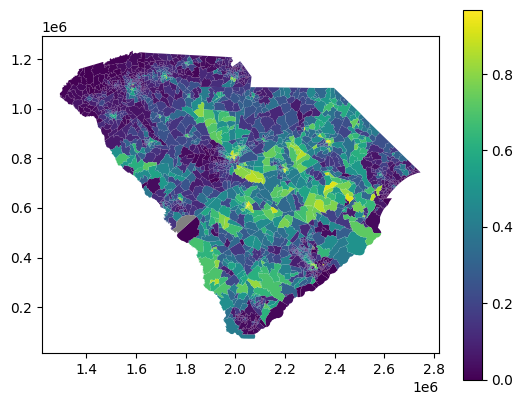

In [34]:
# Plot the black population percentage by precincts
check_gdf['b_frac'] = pd.to_numeric(check_gdf['POPBAA'])/pd.to_numeric(check_gdf['TOTPOP'])
ax = check_gdf.plot(column = 'b_frac', missing_kwds = {"color":"grey"}, legend=True)

# Save the figure as a PNG file
plt.savefig('./graphics/sc-blk-pop.png', dpi=300, bbox_inches='tight') 
plt.show()

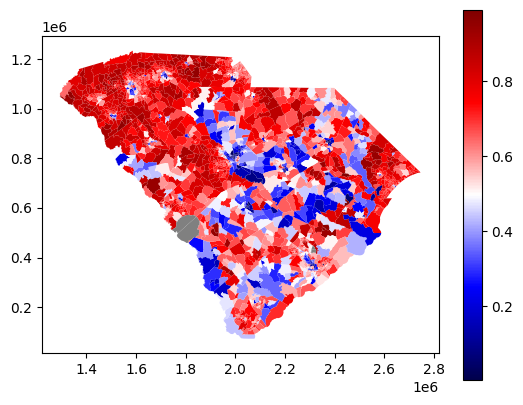

In [35]:
# Plot the senate republican votes by precincts 	
check_gdf['senate_r_perc'] = pd.to_numeric(check_gdf['G22USSRSCO'])/pd.to_numeric(check_gdf["G22USSRSCO"] + check_gdf["G22USSDMAT"])
ax = check_gdf.plot(column = 'senate_r_perc', cmap = "seismic", missing_kwds = {"color":"grey"}, legend=True)

# Save the figure as a PNG file
plt.savefig('./graphics/sc-dem-rep-pop.png', dpi=300, bbox_inches='tight') 
plt.show()

Looks like it!

## Saving

In [37]:
# Save data to a shapefile so we don't have to join all the data again
sc_data_gdf.to_file("./save-new-data/sc-election-census-data-by-precincts.shp")